In [1]:
import pandas as pd
df=pd.read_excel("Placement_Data 1.xlsx")
df.head()

,sl_no,gender,ssc_p,ssc_b,hsc_p,hsc_b,hsc_s,degree_p,degree_t,workex,etest_p,specialisation,mba_p,status,salary
0,1,M,67.00,Others,91.00,Others,Commerce,58.00,Sci&Tech,No,55.0,Mkt&HR,58.80,Placed,270000.0
1,2,M,79.33,Central,78.33,Others,Science,77.48,Sci&Tech,Yes,86.5,Mkt&Fin,66.28,Placed,200000.0
2,3,M,65.00,Central,68.00,Central,Arts,64.00,Comm&Mgmt,No,75.0,Mkt&Fin,57.80,Placed,250000.0
3,4,M,56.00,Central,52.00,Central,Science,52.00,Sci&Tech,No,66.0,Mkt&HR,59.43,Not Placed,NaN
4,5,M,85.80,Central,73.60,Central,Commerce,73.30,Comm&Mgmt,No,96.8,Mkt&Fin,55.50,Placed,425000.0


In [2]:
df.fillna(0,inplace=True)


In [3]:
df.columns

Index(['sl_no', 'gender', 'ssc_p', 'ssc_b', 'hsc_p', 'hsc_b', 'hsc_s',
       'degree_p', 'degree_t', 'workex', 'etest_p', 'specialisation', 'mba_p',
       'status', 'salary'],
      dtype='object')

In [4]:
df.select_dtypes(include='object')

,gender,ssc_b,hsc_b,hsc_s,degree_t,workex,specialisation,status
0,M,Others,Others,Commerce,Sci&Tech,No,Mkt&HR,Placed
1,M,Central,Others,Science,Sci&Tech,Yes,Mkt&Fin,Placed
2,M,Central,Central,Arts,Comm&Mgmt,No,Mkt&Fin,Placed
3,M,Central,Central,Science,Sci&Tech,No,Mkt&HR,Not Placed
4,M,Central,Central,Commerce,Comm&Mgmt,No,Mkt&Fin,Placed
...,...,...,...,...,...,...,...,...
210,M,Others,Others,Commerce,Comm&Mgmt,No,Mkt&Fin,Placed
211,M,Others,Others,Science,Sci&Tech,No,Mkt&Fin,Placed
212,M,Others,Others,Commerce,Comm&Mgmt,Yes,Mkt&Fin,Placed
213,F,Others,Others,Commerce,Comm&Mgmt,No,Mkt&HR,Placed


In [5]:
for i in df.select_dtypes(include='object'):
    print(i,"====",df[i].unique())

gender ==== ['M' 'F']
ssc_b ==== ['Others' 'Central']
hsc_b ==== ['Others' 'Central']
hsc_s ==== ['Commerce' 'Science' 'Arts']
degree_t ==== ['Sci&Tech' 'Comm&Mgmt' 'Others']
workex ==== ['No' 'Yes']
specialisation ==== ['Mkt&HR' 'Mkt&Fin']
status ==== ['Placed' 'Not Placed']


In [6]:
df[["ssc_p","hsc_p"]].corr()

,ssc_p,hsc_p
ssc_p,1.000000,0.511472
hsc_p,0.511472,1.000000


In [7]:

int_columns = df.select_dtypes(include={'float','int'})

correlation_matrix = int_columns.corr()

print(correlation_matrix)

             sl_no     ssc_p     hsc_p  degree_p   etest_p     mba_p    salary
sl_no     1.000000 -0.078155 -0.085711 -0.088281  0.063636  0.022327  0.002543
ssc_p    -0.078155  1.000000  0.511472  0.538404  0.261993  0.388478  0.538090
hsc_p    -0.085711  0.511472  1.000000  0.434206  0.245113  0.354823  0.452569
degree_p -0.088281  0.538404  0.434206  1.000000  0.224470  0.402364  0.408371
etest_p   0.063636  0.261993  0.245113  0.224470  1.000000  0.218055  0.186988
mba_p     0.022327  0.388478  0.354823  0.402364  0.218055  1.000000  0.139823
salary    0.002543  0.538090  0.452569  0.408371  0.186988  0.139823  1.000000


In [8]:
df["gender"]=df["gender"].map({
    "M":0,
    "F":1
})
df["ssc_b"]=df["ssc_b"].map({
    "Others":0,
    "Central":1
})
df["hsc_b"]=df["hsc_b"].map({
    "Others":0,
    "Central":1
})
df["degree_t"]=df["degree_t"].map({
    "Sci&Tech":0,
    "Comm&Mgmt":1,
    "Others":2
})
df["workex"]=df["workex"].map({
    "No":0,
    "Yes":1
})
df["specialisation"]=df["specialisation"].map({
    "Mkt&HR":0,
    "Mkt&Fin":1
})
df["status"]=df["status"].map({
    "Placed":0,
    "Not Placed":1
})
df["hsc_s"]=df["hsc_s"].map({
    "Commerce":0,
    "Science":1,
    "Arts":2
})

In [9]:
from sklearn.preprocessing import LabelEncoder

In [10]:
x=df.iloc[:,1:-1].values
print(x)
y=df.iloc[:,-1].values
print("\ntarget\n")
print(y)

[[ 0.   67.    0.   ...  0.   58.8   0.  ]
 [ 0.   79.33  1.   ...  1.   66.28  0.  ]
 [ 0.   65.    1.   ...  1.   57.8   0.  ]
 ...
 [ 0.   67.    0.   ...  1.   69.72  0.  ]
 [ 1.   74.    0.   ...  0.   60.23  0.  ]
 [ 0.   62.    1.   ...  0.   60.22  1.  ]]

target

[270000. 200000. 250000.      0. 425000.      0.      0. 252000. 231000.
      0. 260000. 250000.      0. 218000.      0. 200000. 300000.      0.
      0. 236000. 265000. 393000. 360000. 300000. 360000.      0. 240000.
 265000. 350000.      0. 250000.      0. 278000. 260000.      0. 300000.
      0. 320000. 240000. 411000. 287000.      0.      0. 300000. 200000.
      0.      0. 204000. 250000.      0. 200000.      0.      0. 450000.
 216000. 220000. 240000. 360000. 268000. 265000. 260000. 300000. 240000.
      0. 240000.      0. 275000. 275000.      0. 275000. 360000. 240000.
 240000. 218000. 336000.      0. 230000. 500000. 270000.      0. 240000.
 300000.      0. 300000. 300000. 400000. 220000.      0. 210000. 21000

In [11]:
from sklearn.model_selection import train_test_split

In [12]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.25,random_state=5)

In [13]:
from sklearn.linear_model import LinearRegression
reg=LinearRegression()
reg.fit(x_train,y_train)

LinearRegression()

In [14]:
y_pred=reg.predict(x_test)
y_pred

array([275408.97982675, 252659.29556144, 276351.77576432, 318615.84809325,
       291580.74205749, 283567.9805833 , 290780.50973875, 298762.92489274,
       -54218.03116221, 294017.36792828, 293260.928442  ,  23164.53287212,
       255068.84097645, 330386.80459069,  10518.21682849,   6056.24236402,
       307820.89191545, 251097.58920089,   3190.71564996, 280859.82579278,
       266814.81795713, 232859.2462135 , 260035.94304831, -53285.40032924,
       269094.42913075, 285779.4442256 , 289725.69519795,   8557.6700129 ,
       261458.92997539,  23507.63857033, 267922.80640022, -20687.99803224,
        18297.16901449,  25342.53652624,  -3004.16680781,  21276.80082838,
          750.31066969, 275772.64666657,  34306.08738076, 277023.98397983,
       340029.72887063,  -3233.16590791,   3193.58654706,  19352.35177384,
       316057.13442639, 291325.8969312 , 262590.33296588, 298242.68393792,
       310015.74368427, 262873.05758484, 255768.75621418,  27713.88512555,
       268531.6071346 , 3

In [15]:
from sklearn import metrics
MSE=metrics.mean_absolute_error(y_test,y_pred)
MSE

50149.89655167834

In [16]:
import numpy as np
RMSE=np.sqrt(MSE)
RMSE

223.94172579418588

In [17]:
R2=metrics.r2_score(y_test,y_pred)
R2

0.6804647944782389

In [18]:
dummy_df1=df.copy()

In [19]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

In [20]:
poly_model=make_pipeline(PolynomialFeatures (degree=1),LinearRegression())
poly_model.fit(x_train,y_train)

Pipeline(steps=[('polynomialfeatures', PolynomialFeatures(degree=1)),
                ('linearregression', LinearRegression())])

In [21]:
y_pred_poly=poly_model.predict(x_test)


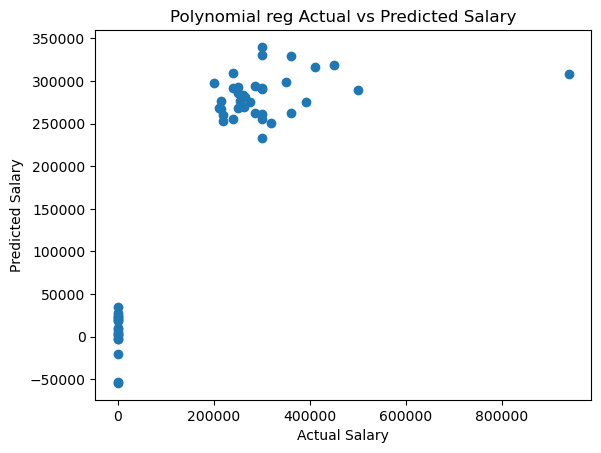

In [22]:
import matplotlib.pyplot as plt
plt.scatter(y_test,y_pred_poly)
plt.xlabel('Actual Salary')
plt.ylabel('Predicted Salary')
plt.title('Polynomial reg Actual vs Predicted Salary')
plt.show()

In [23]:
accuracy=metrics.r2_score(y_test,y_pred_poly)
accuracy

0.6804647944782392

In [24]:
x=df.iloc[:,1:-2].values
print(x.shape)
y=df['status']
print("\ntarget\n")
print(y)

(215, 12)

target

0      0
1      0
2      0
3      1
4      0
      ..
210    0
211    0
212    0
213    0
214    1
Name: status, Length: 215, dtype: int64


In [25]:
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.29,random_state=50)

#filterise data 

In [26]:
from sklearn.preprocessing import StandardScaler

In [27]:
ss=StandardScaler()

In [28]:
X_train=ss.fit_transform(x_train)
X_test=ss.fit_transform(x_test)

In [29]:
y_train

54     0
13     0
37     0
99     1
206    1
      ..
132    0
33     0
109    1
139    0
176    0
Name: status, Length: 152, dtype: int64

In [30]:
y_test

146    0
73     0
121    0
1      0
23     0
      ..
40     0
205    0
201    1
82     1
96     0
Name: status, Length: 63, dtype: int64

In [31]:
from sklearn.linear_model import LogisticRegression
classifier=LogisticRegression()
classifier.fit(X_train,y_train)

LogisticRegression()

In [32]:
Y_Pred=classifier.predict(X_test)

In [33]:
Y_Pred

array([0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1,
       1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0],
      dtype=int64)

In [34]:
y_test
y_test.value_counts()

status
0    48
1    15
Name: count, dtype: int64

In [35]:
from sklearn.metrics import confusion_matrix

In [36]:
confusion_matrix(y_test,Y_Pred)

array([[41,  7],
       [ 3, 12]], dtype=int64)

In [37]:
tn,fp,fn,tp=confusion_matrix(y_test,Y_Pred).ravel()

<Axes: >

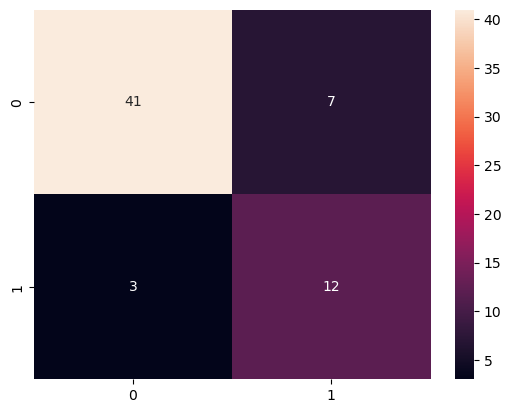

In [38]:
import seaborn as sns
sns.heatmap(confusion_matrix(y_test,Y_Pred),annot=True)

In [39]:
from sklearn.metrics import accuracy_score
accuracy_score(y_test,Y_Pred)
#accuracy formula=(tp+tn/tp+tn+fp+fn)

0.8412698412698413

In [40]:
from sklearn.metrics import roc_auc_score
roc_auc_score(y_test,Y_Pred)

0.8270833333333333

In [41]:
from sklearn.metrics import recall_score,precision_score

In [42]:
y_pred2=(classifier.predict_proba(X_test)[:,1]>=0.7).astype(int)
print(y_pred2)
print(y_pred)

print(f"accuracy of the  logistic reg of 0.7 thresold:{accuracy_score(y_test,y_pred2)*100}")

print(f"roc auc score at 0.7 thresold:{roc_auc_score(y_test,y_pred2)}")

print(f"recall at 0.7 thresold:{recall_score(y_test,y_pred2)*100}")

print(f"precision score at 0.7 thresold:{precision_score(y_test,y_pred2)}")




[0 0 1 0 0 0 0 0 1 0 1 1 0 0 0 0 0 0 0 1 0 0 1 0 0 0 1 1 1 0 0 0 0 1 1 0 0
 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 1 0 0 0 0 1 0 0]
[275408.97982675 252659.29556144 276351.77576432 318615.84809325
 291580.74205749 283567.9805833  290780.50973875 298762.92489274
 -54218.03116221 294017.36792828 293260.928442    23164.53287212
 255068.84097645 330386.80459069  10518.21682849   6056.24236402
 307820.89191545 251097.58920089   3190.71564996 280859.82579278
 266814.81795713 232859.2462135  260035.94304831 -53285.40032924
 269094.42913075 285779.4442256  289725.69519795   8557.6700129
 261458.92997539  23507.63857033 267922.80640022 -20687.99803224
  18297.16901449  25342.53652624  -3004.16680781  21276.80082838
    750.31066969 275772.64666657  34306.08738076 277023.98397983
 340029.72887063  -3233.16590791   3193.58654706  19352.35177384
 316057.13442639 291325.8969312  262590.33296588 298242.68393792
 310015.74368427 262873.05758484 255768.75621418  27713.88512555
 268531.6071346  329288.233

In [43]:
y_pred2=(classifier.predict_proba(X_test)[:,1]>=0.8).astype(int)
print(y_pred2)
print(y_pred)

print(f"accuracy of the  logistic reg of 0.7 thresold:{accuracy_score(y_test,y_pred2)*100}")

print(f"roc auc score at 0.7 thresold:{roc_auc_score(y_test,y_pred2)}")

print(f"recall at 0.7 thresold:{recall_score(y_test,y_pred2)*100}")

print(f"precision score at 0.7 thresold:{precision_score(y_test,y_pred2)}")

[0 0 1 0 0 0 0 0 1 0 1 1 0 0 0 0 0 0 0 1 0 0 1 0 0 0 1 1 1 0 0 0 0 1 1 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0]
[275408.97982675 252659.29556144 276351.77576432 318615.84809325
 291580.74205749 283567.9805833  290780.50973875 298762.92489274
 -54218.03116221 294017.36792828 293260.928442    23164.53287212
 255068.84097645 330386.80459069  10518.21682849   6056.24236402
 307820.89191545 251097.58920089   3190.71564996 280859.82579278
 266814.81795713 232859.2462135  260035.94304831 -53285.40032924
 269094.42913075 285779.4442256  289725.69519795   8557.6700129
 261458.92997539  23507.63857033 267922.80640022 -20687.99803224
  18297.16901449  25342.53652624  -3004.16680781  21276.80082838
    750.31066969 275772.64666657  34306.08738076 277023.98397983
 340029.72887063  -3233.16590791   3193.58654706  19352.35177384
 316057.13442639 291325.8969312  262590.33296588 298242.68393792
 310015.74368427 262873.05758484 255768.75621418  27713.88512555
 268531.6071346  329288.233

In [44]:
y_pred2=(classifier.predict_proba(X_test)[:,1]>=0.9).astype(int)
print(y_pred2)
print(y_pred)

print(f"accuracy of the  logistic reg of 0.9 thresold:{accuracy_score(y_test,y_pred2)*100}")

print(f"roc auc score at 0.9 thresold:{roc_auc_score(y_test,y_pred2)}")

print(f"recall at 0.9 thresold:{recall_score(y_test,y_pred2)*100}")

print(f"precision score at 0.9 thresold:{precision_score(y_test,y_pred2)}")





[0 0 0 0 0 0 0 0 1 0 1 1 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 1 0 0 0 0 0 1 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0]
[275408.97982675 252659.29556144 276351.77576432 318615.84809325
 291580.74205749 283567.9805833  290780.50973875 298762.92489274
 -54218.03116221 294017.36792828 293260.928442    23164.53287212
 255068.84097645 330386.80459069  10518.21682849   6056.24236402
 307820.89191545 251097.58920089   3190.71564996 280859.82579278
 266814.81795713 232859.2462135  260035.94304831 -53285.40032924
 269094.42913075 285779.4442256  289725.69519795   8557.6700129
 261458.92997539  23507.63857033 267922.80640022 -20687.99803224
  18297.16901449  25342.53652624  -3004.16680781  21276.80082838
    750.31066969 275772.64666657  34306.08738076 277023.98397983
 340029.72887063  -3233.16590791   3193.58654706  19352.35177384
 316057.13442639 291325.8969312  262590.33296588 298242.68393792
 310015.74368427 262873.05758484 255768.75621418  27713.88512555
 268531.6071346  329288.233

In [45]:

df.head(10)

,sl_no,gender,ssc_p,ssc_b,hsc_p,hsc_b,hsc_s,degree_p,degree_t,workex,etest_p,specialisation,mba_p,status,salary
0,1,0,67.00,0,91.00,0,0,58.00,0,0,55.00,0,58.80,0,270000.0
1,2,0,79.33,1,78.33,0,1,77.48,0,1,86.50,1,66.28,0,200000.0
2,3,0,65.00,1,68.00,1,2,64.00,1,0,75.00,1,57.80,0,250000.0
3,4,0,56.00,1,52.00,1,1,52.00,0,0,66.00,0,59.43,1,0.0
4,5,0,85.80,1,73.60,1,0,73.30,1,0,96.80,1,55.50,0,425000.0
5,6,0,55.00,0,49.80,0,1,67.25,0,1,55.00,1,51.58,1,0.0
6,7,1,46.00,0,49.20,0,0,79.00,1,0,74.28,1,53.29,1,0.0
7,8,0,82.00,1,64.00,1,1,66.00,0,1,67.00,1,62.14,0,252000.0
8,9,0,73.00,1,79.00,1,0,72.00,1,0,91.34,1,61.29,0,231000.0
9,10,0,58.00,1,70.00,1,0,61.00,1,0,54.00,1,52.21,1,0.0


In [46]:
x_decision_tree=df.drop({"status","salary"},axis=1).values
x_decision_tree

array([[  1.  ,   0.  ,  67.  , ...,  55.  ,   0.  ,  58.8 ],
       [  2.  ,   0.  ,  79.33, ...,  86.5 ,   1.  ,  66.28],
       [  3.  ,   0.  ,  65.  , ...,  75.  ,   1.  ,  57.8 ],
       ...,
       [213.  ,   0.  ,  67.  , ...,  59.  ,   1.  ,  69.72],
       [214.  ,   1.  ,  74.  , ...,  70.  ,   0.  ,  60.23],
       [215.  ,   0.  ,  62.  , ...,  89.  ,   0.  ,  60.22]])

In [47]:
y_decision_tree=df["status"].values
y_decision_tree

array([0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0,
       0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1,
       0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 1,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0,
       0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1,
       0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0,
       1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1], dtype=int64)

In [48]:
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test=train_test_split(x_decision_tree,y_decision_tree,test_size=0.30,random_state=50)


In [49]:
from sklearn.tree import DecisionTreeClassifier
dc_gini=DecisionTreeClassifier(criterion='gini',random_state=42)
dc_gini.fit(x_train,y_train)

y_pred_decision_tree=dc_gini.predict(x_test)
confusion_matrix(y_test,y_pred_decision_tree)

array([[44,  6],
       [ 4, 11]], dtype=int64)

In [50]:

accuracy_scores=accuracy_score(y_test,y_pred_decision_tree)
accuracy_scores

0.8461538461538461

In [51]:
from sklearn.metrics import classification_report
print(classification_report(y_test,y_pred_decision_tree))

              precision    recall  f1-score   support

           0       0.92      0.88      0.90        50
           1       0.65      0.73      0.69        15

    accuracy                           0.85        65
   macro avg       0.78      0.81      0.79        65
weighted avg       0.85      0.85      0.85        65



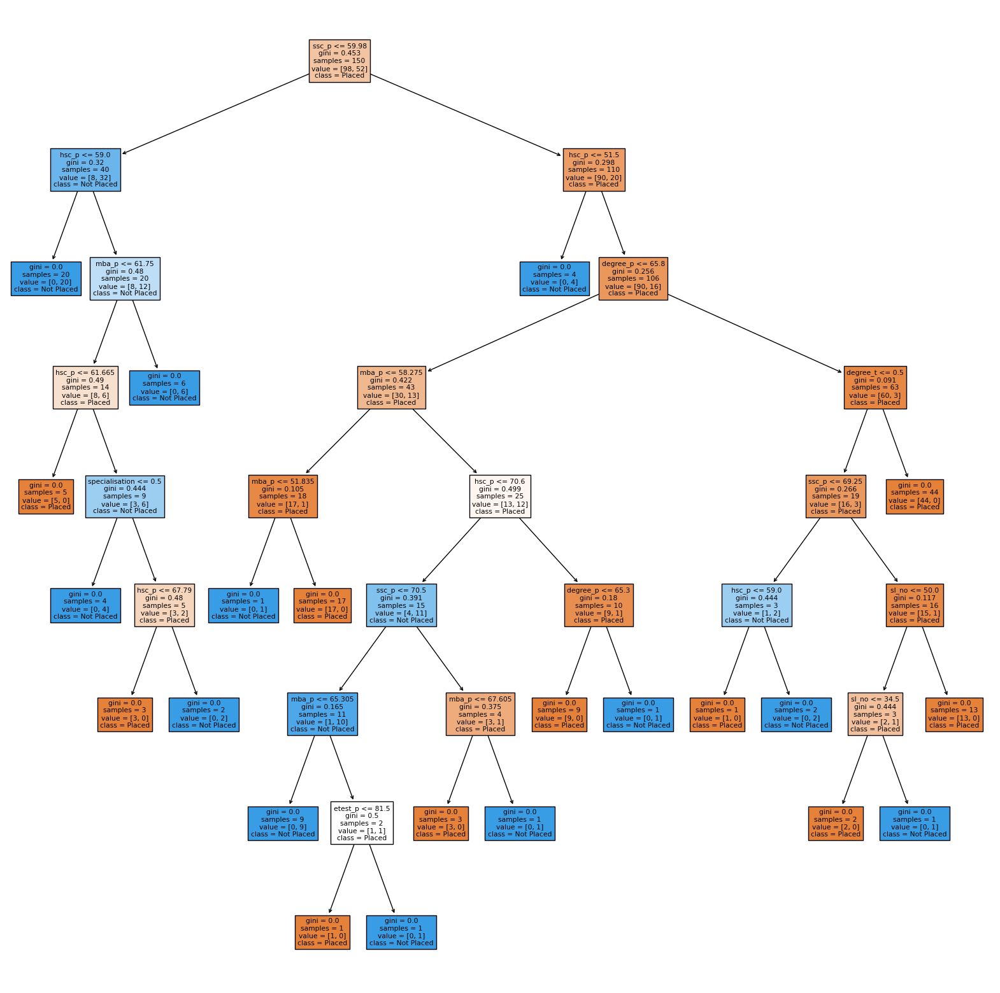

In [52]:
from sklearn import tree
plt.figure(figsize=(20,20))
tree.plot_tree(dc_gini,feature_names=df.columns[:-2].tolist(),class_names=["Placed","Not Placed"],filled=True)
plt.show()

In [53]:
dc_entropy=DecisionTreeClassifier(criterion='entropy',random_state=42)
dc_entropy.fit(x_train,y_train)

y_pred_decision_tree=dc_entropy.predict(x_test)

confusion_matrix(y_test,y_pred_decision_tree)

array([[39, 11],
       [ 2, 13]], dtype=int64)

In [54]:
print(f"accuracy of Decision Tree entropy :",(accuracy_score(y_test,y_pred_decision_tree)))

from sklearn.metrics import classification_report
print(f"classification report : ",classification_report(y_test,y_pred_decision_tree))

accuracy of Decision Tree entropy : 0.8
classification report :                precision    recall  f1-score   support

           0       0.95      0.78      0.86        50
           1       0.54      0.87      0.67        15

    accuracy                           0.80        65
   macro avg       0.75      0.82      0.76        65
weighted avg       0.86      0.80      0.81        65



In [55]:
from sklearn.preprocessing import LabelEncoder
le=LabelEncoder
df_dummy_labelencoding=df.copy()
for i in df_dummy_labelencoding.select_dtypes(include="object"):
    df_dummy_labelencoding[i]=le.fit_transform(df_dummy_labelencoding[i])
df_dummy_labelencoding

,sl_no,gender,ssc_p,ssc_b,hsc_p,hsc_b,hsc_s,degree_p,degree_t,workex,etest_p,specialisation,mba_p,status,salary
0,1,0,67.00,0,91.00,0,0,58.00,0,0,55.0,0,58.80,0,270000.0
1,2,0,79.33,1,78.33,0,1,77.48,0,1,86.5,1,66.28,0,200000.0
2,3,0,65.00,1,68.00,1,2,64.00,1,0,75.0,1,57.80,0,250000.0
3,4,0,56.00,1,52.00,1,1,52.00,0,0,66.0,0,59.43,1,0.0
4,5,0,85.80,1,73.60,1,0,73.30,1,0,96.8,1,55.50,0,425000.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
210,211,0,80.60,0,82.00,0,0,77.60,1,0,91.0,1,74.49,0,400000.0
211,212,0,58.00,0,60.00,0,1,72.00,0,0,74.0,1,53.62,0,275000.0
212,213,0,67.00,0,67.00,0,0,73.00,1,1,59.0,1,69.72,0,295000.0
213,214,1,74.00,0,66.00,0,0,58.00,1,0,70.0,0,60.23,0,204000.0


In [56]:
x_decision_tree=df_dummy_labelencoding.drop(["status","salary"],axis=1).values

y_decision_tree=df_dummy_labelencoding["status"].values

x_train,x_test,y_train,y_test=train_test_split(x_decision_tree,y_decision_tree,test_size=0.30,random_state=50)

tree_pre_pruned=DecisionTreeClassifier(criterion="gini",max_depth=5,random_state=42)

tree_pre_pruned.fit(x_train,y_train)

y_tree_pre_pruned_predict=tree_pre_pruned.predict(x_test)

y_tree_pre_pruned_predict

array([0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0,
       1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0],
      dtype=int64)

best accuracy after post pruning : 0.8461538461538461


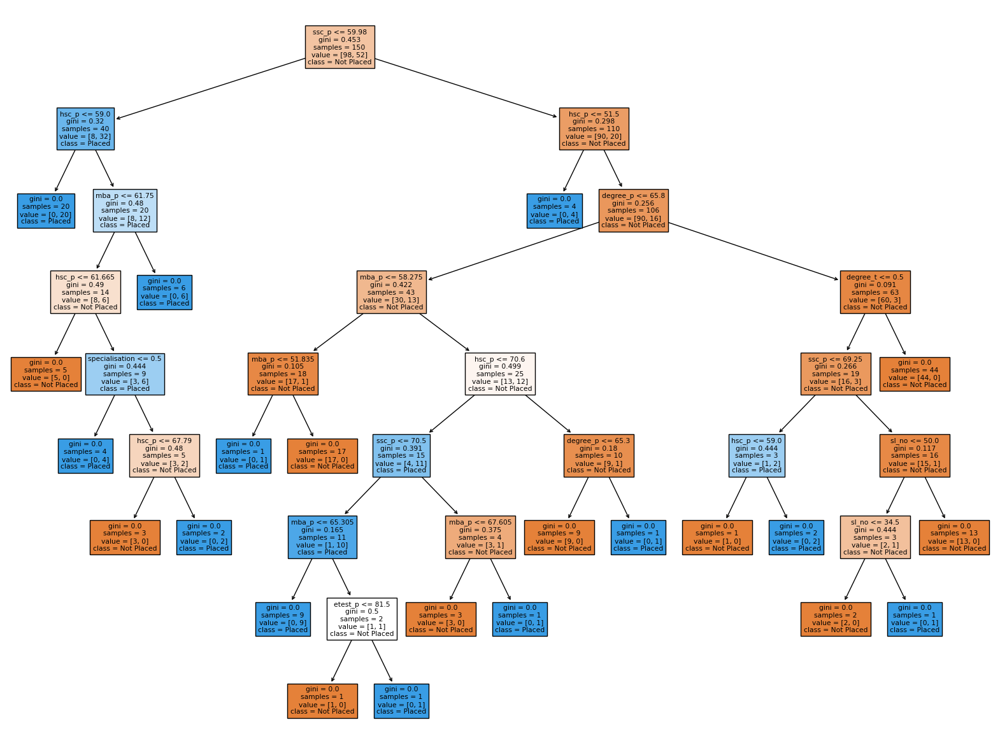

best accuracy after post pruning : 0.8615384615384616


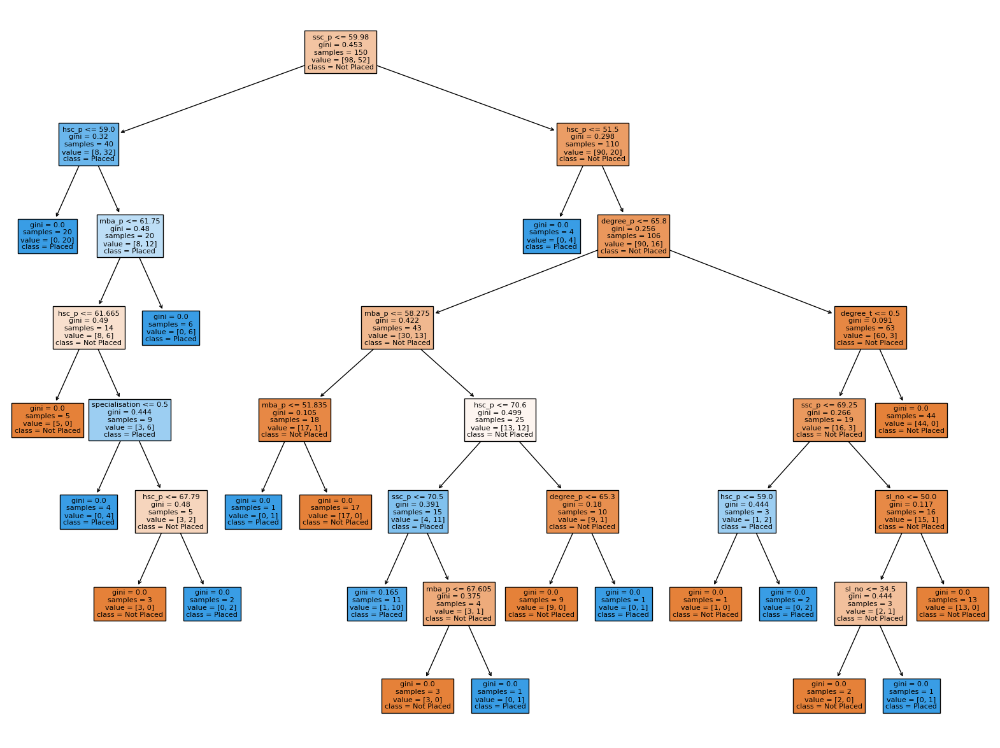

best accuracy after post pruning : 0.8615384615384616


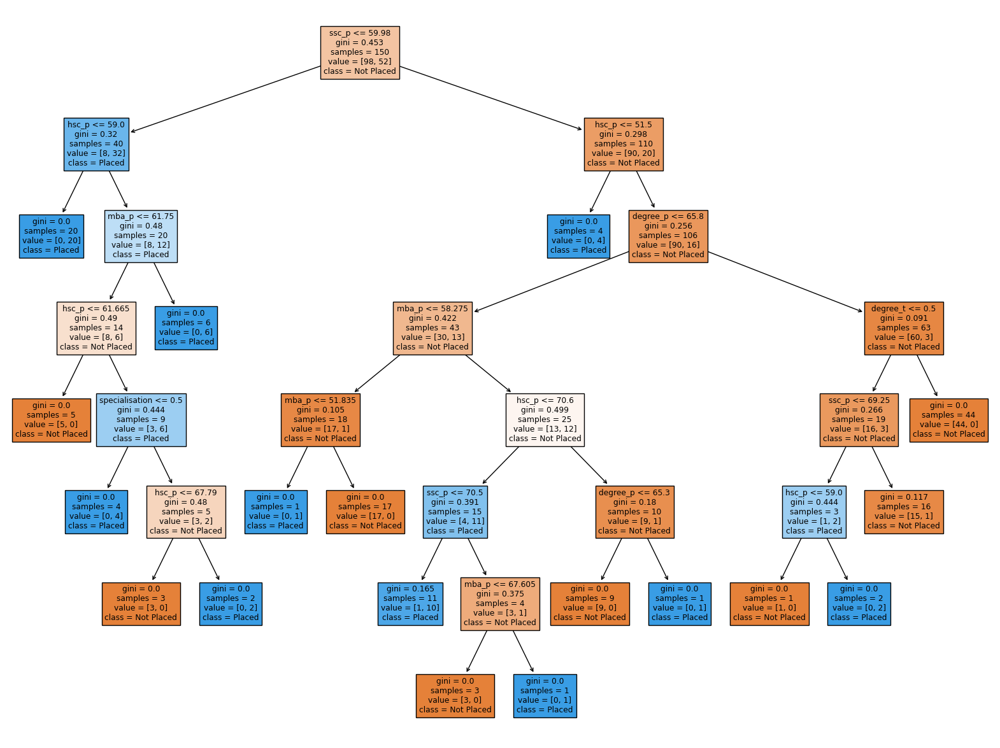

best accuracy after post pruning : 0.8769230769230769


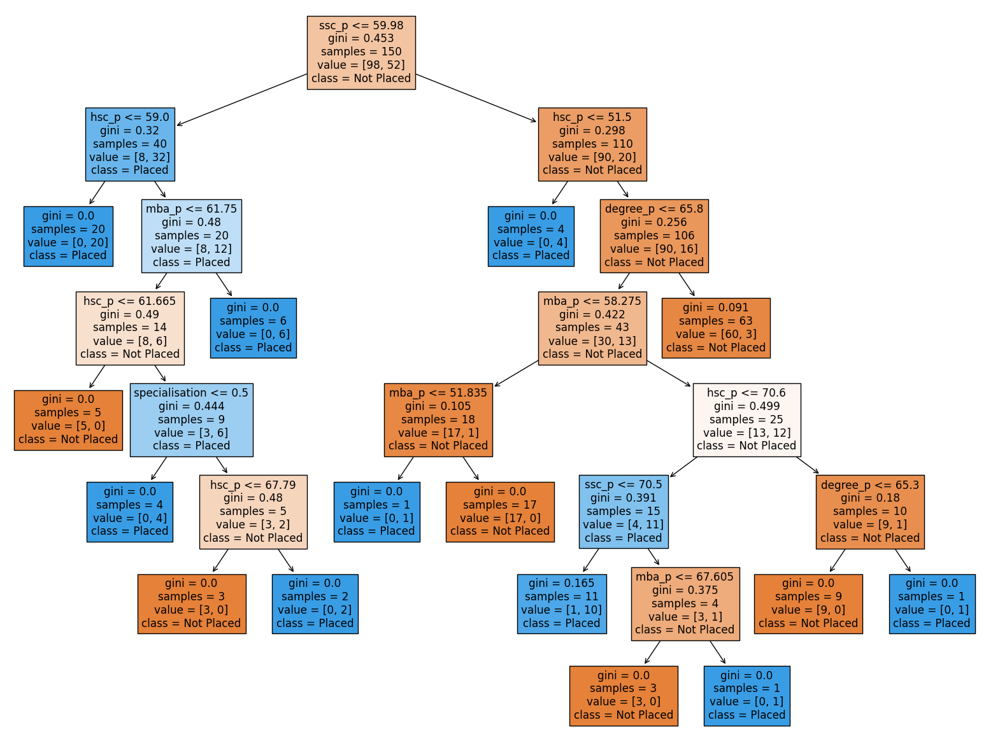

best accuracy after post pruning : 0.8769230769230769


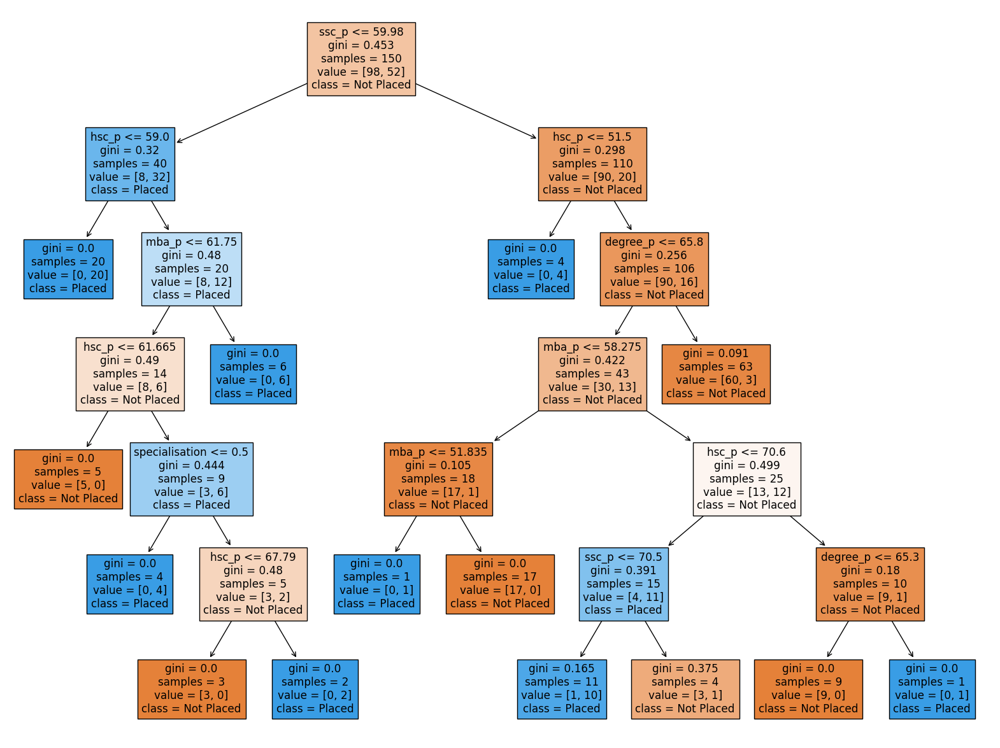

best accuracy after post pruning : 0.8769230769230769


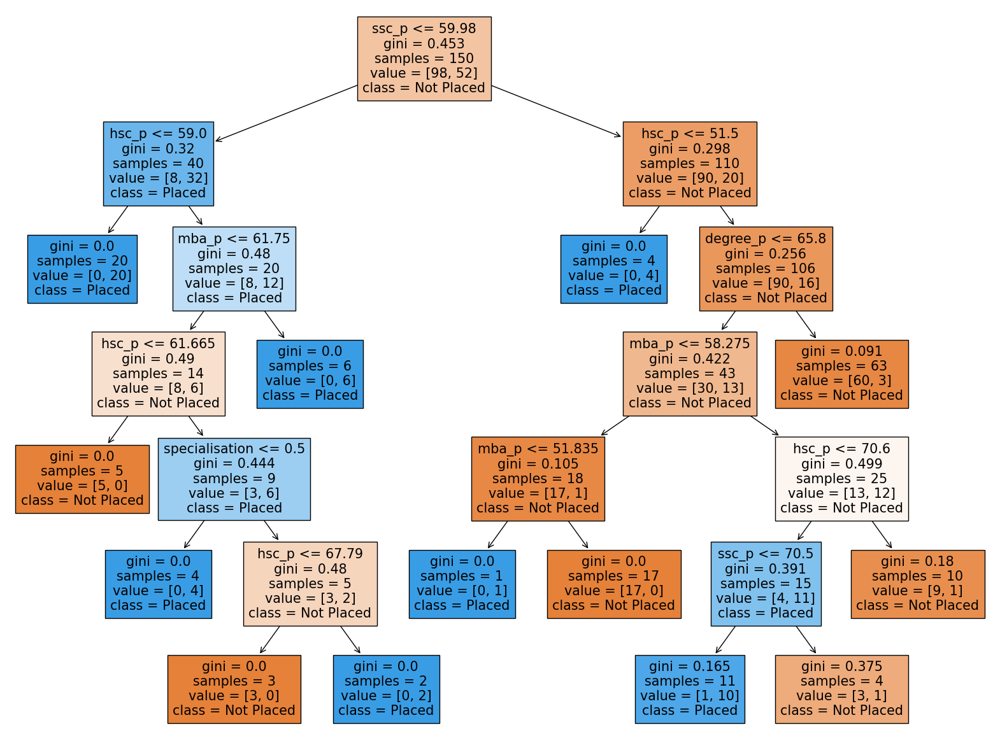

best accuracy after post pruning : 0.8769230769230769


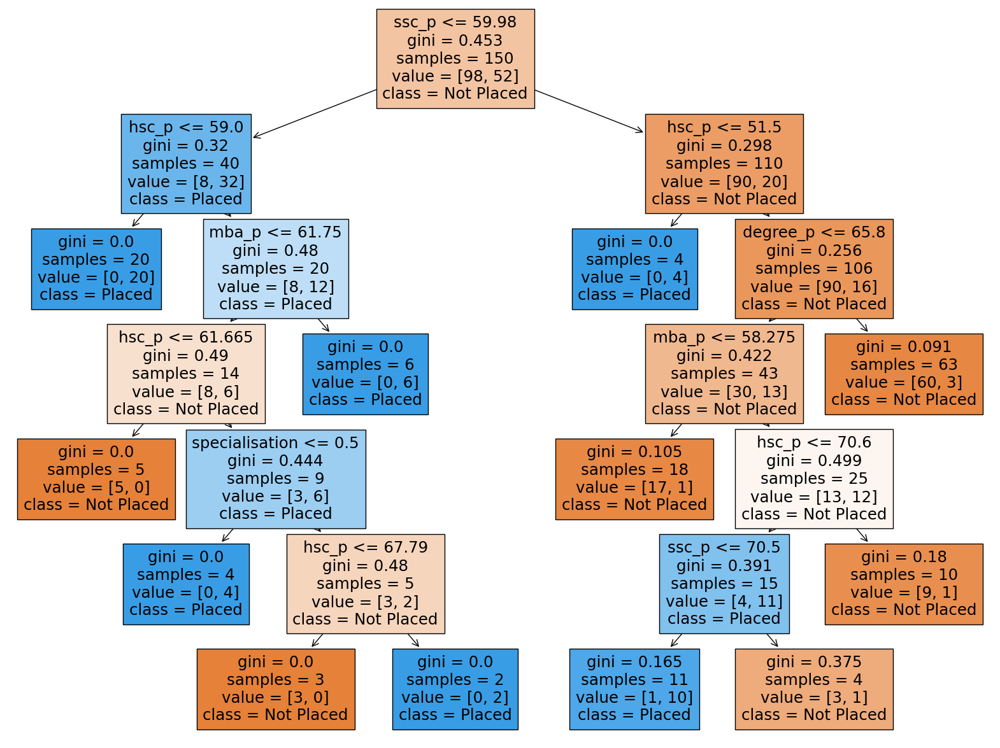

best accuracy after post pruning : 0.8769230769230769


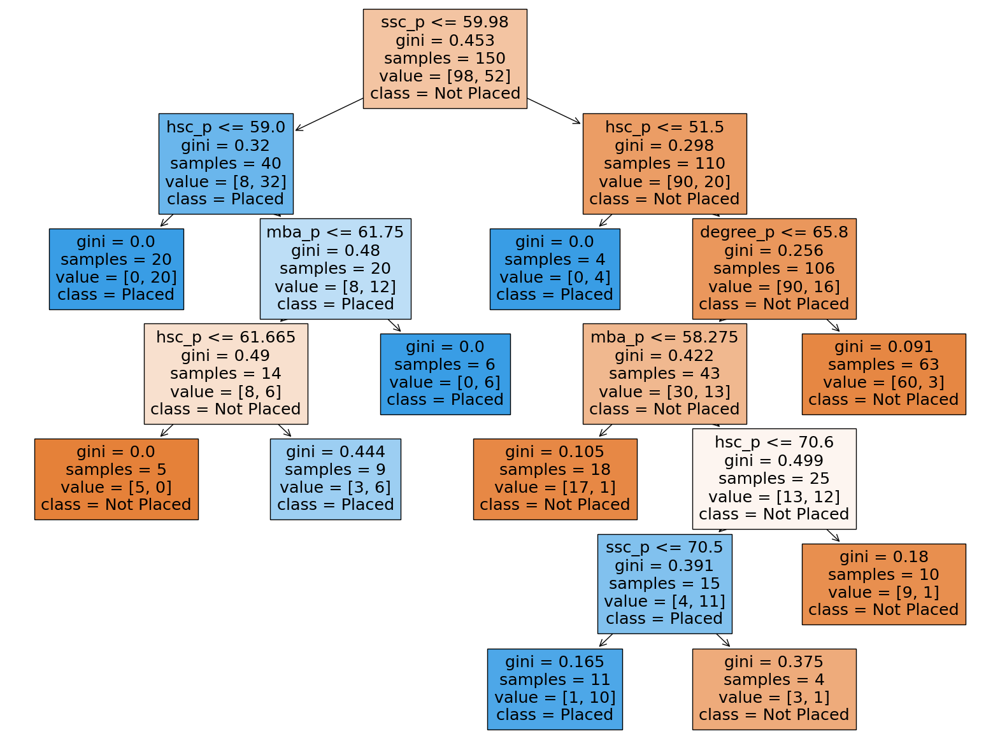

best accuracy after post pruning : 0.8769230769230769


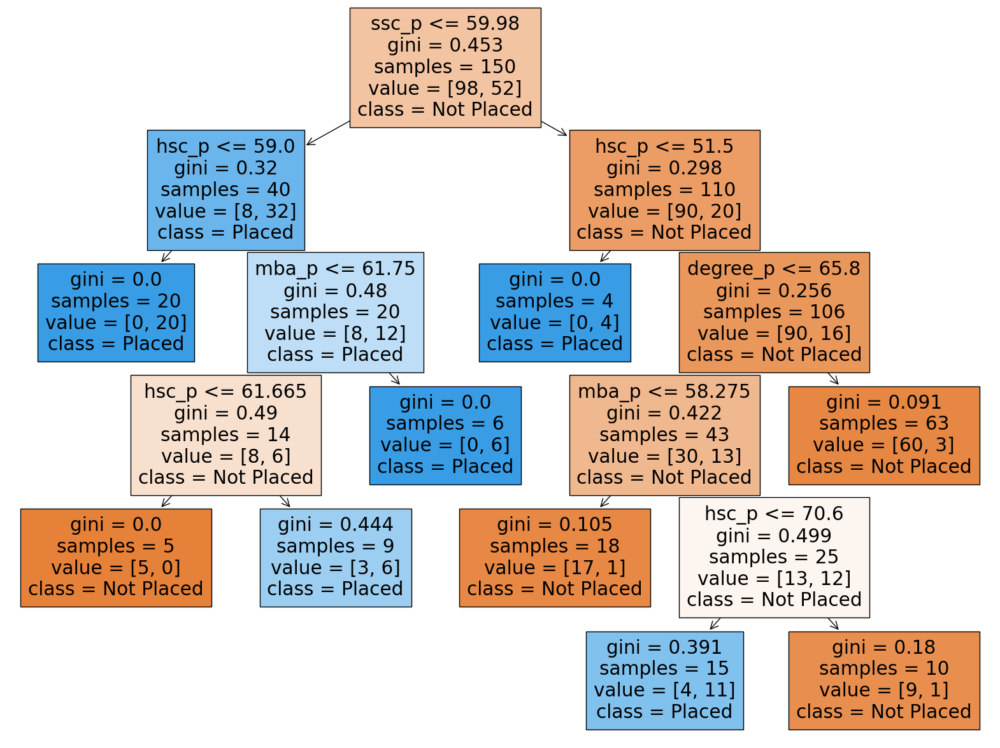

best accuracy after post pruning : 0.8769230769230769


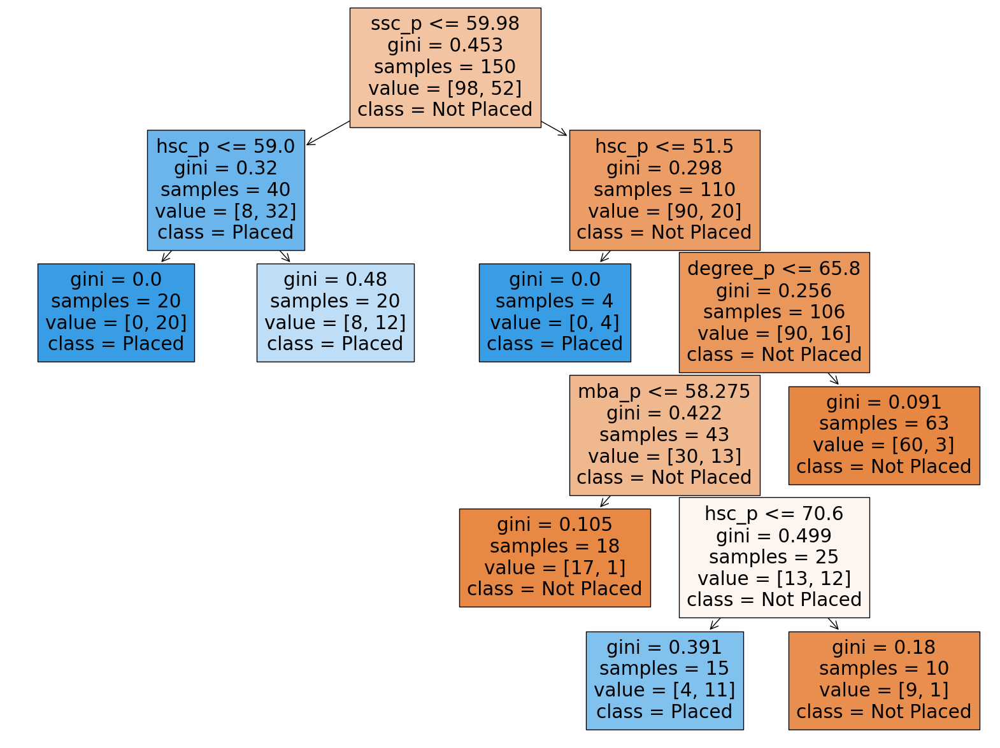

best accuracy after post pruning : 0.8769230769230769


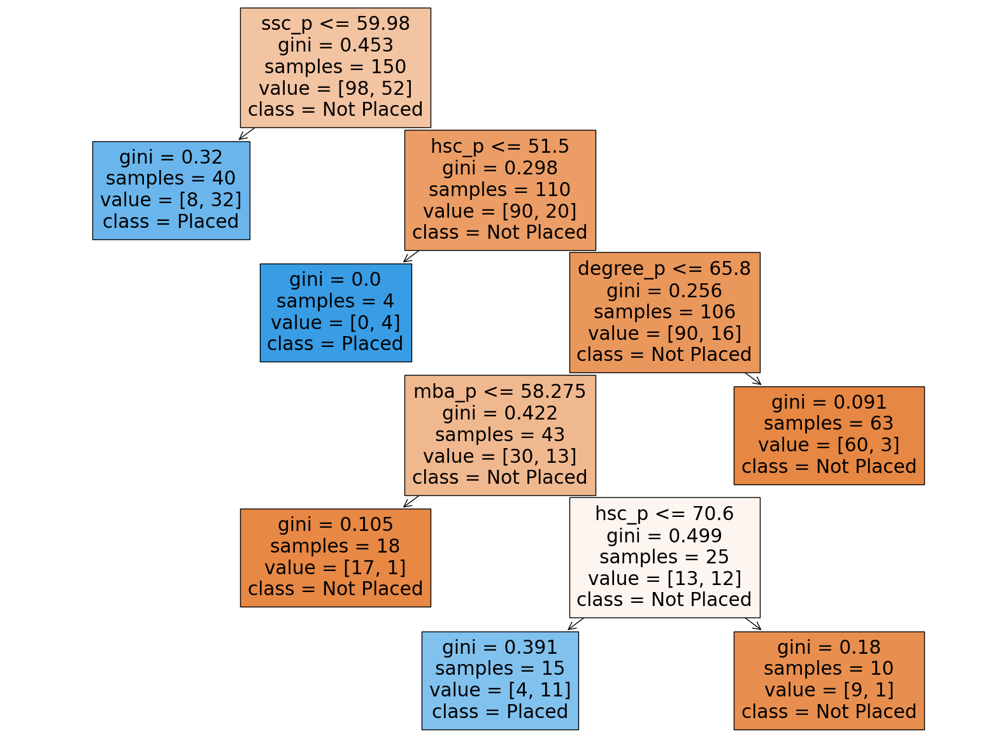

best accuracy after post pruning : 0.8769230769230769


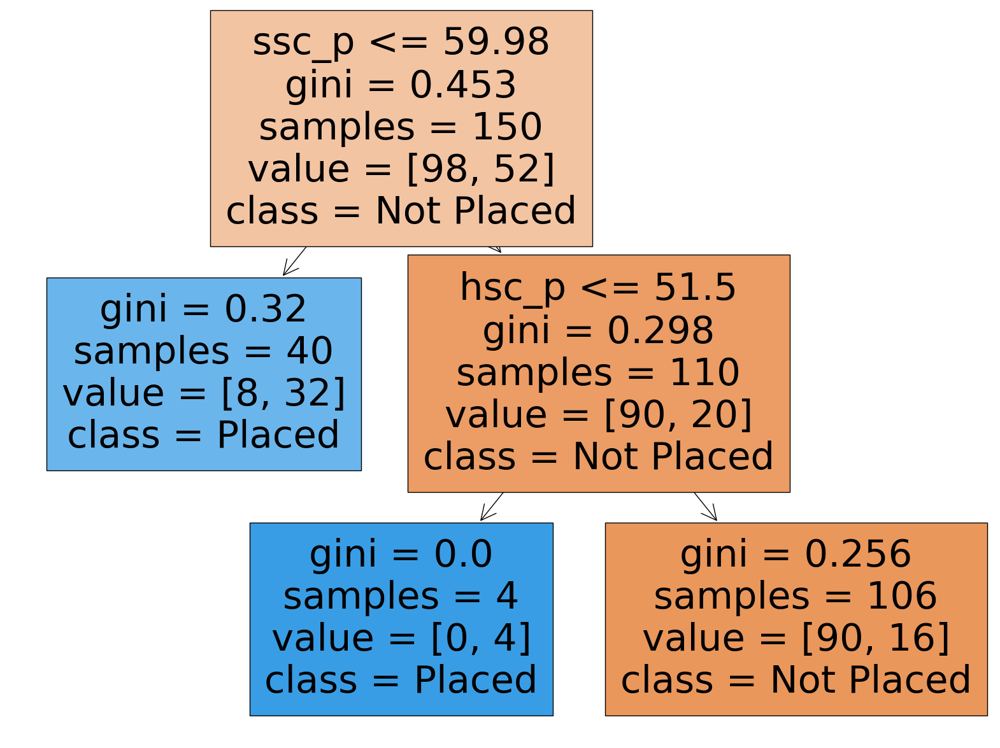

best accuracy after post pruning : 0.8769230769230769


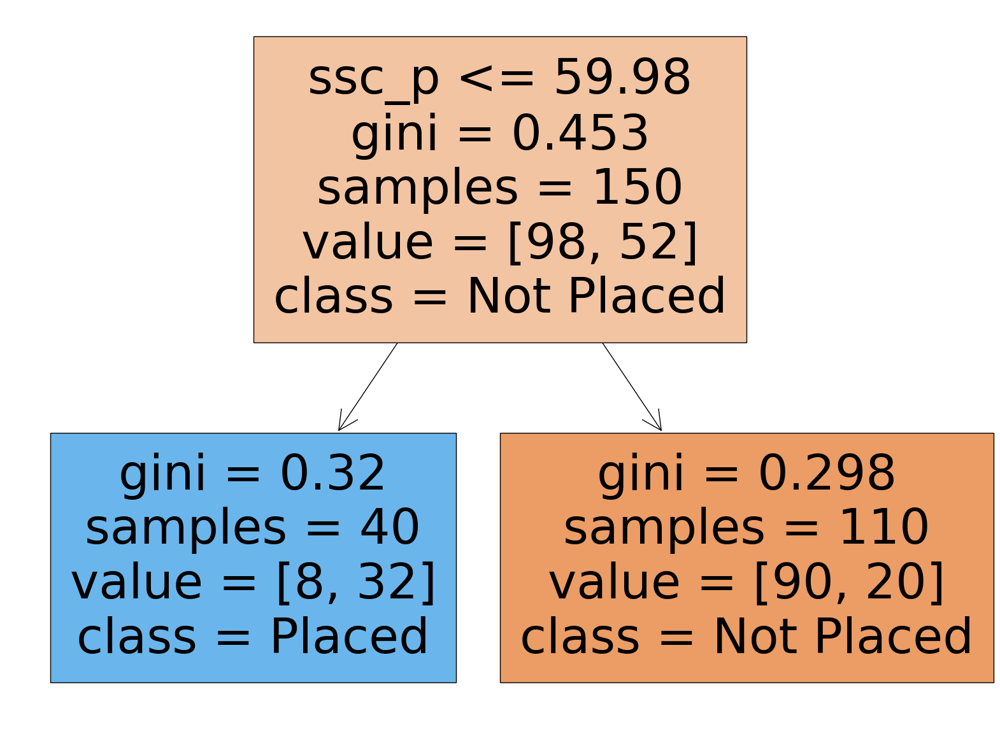

best accuracy after post pruning : 0.8769230769230769


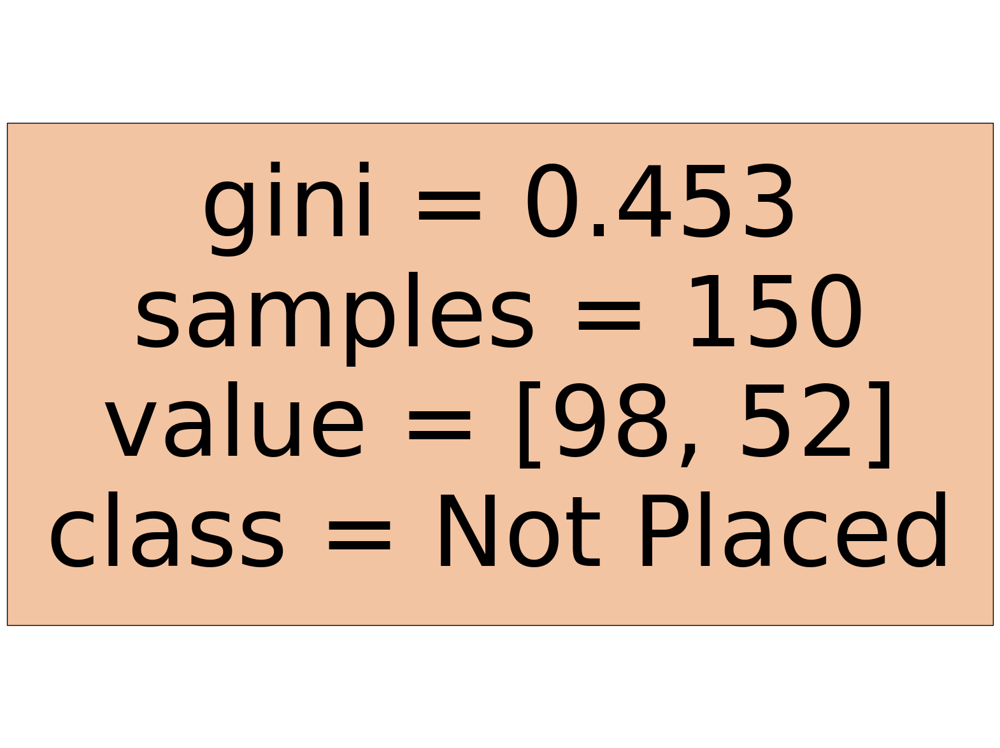

In [57]:
#post_pruning
x_decision_tree=df_dummy_labelencoding.drop(["status","salary"],axis=1).values
Y_decision_tree=df_dummy_labelencoding["status"].values

x_train,x_test,y_train,y_test=train_test_split(x_decision_tree,Y_decision_tree,test_size=0.30,random_state=50)

dc_gini=DecisionTreeClassifier(criterion='gini',random_state=42)
dc_gini.fit(x_train,y_train)

path=dc_gini.cost_complexity_pruning_path(x_train,y_train)
ccp_alphas=path.ccp_alphas

trees=[]
for alpha in ccp_alphas:
    tree_post_pruned=DecisionTreeClassifier(criterion='gini',ccp_alpha=alpha,random_state=42)
    tree_post_pruned.fit(x_train,y_train)
    trees.append(tree_post_pruned)

    accuracies=[accuracy_score(y_test,i.predict(x_test)) for i in trees]
    best_tree=trees[accuracies.index(max(accuracies))]
    print("best accuracy after post pruning :",max(accuracies))



    from sklearn import tree
    plt.figure(figsize=(20,15))
    tree.plot_tree(tree_post_pruned,feature_names=df_dummy_labelencoding.columns[:-2].to_list(),class_names=["Not Placed","Placed"],filled=True)
    plt.show()

In [58]:
import numpy as np
n_estimators=[10,20,30,40,50,60,70,80,90,100,150]
max_features=["sqrt","log2"]
max_depth=np.linspace(10,120,10,dtype=int)
criterion=["gini","entropy"]
min_samples_split=[2,4,6,8,10,12,14,16,18,20]

In [59]:
random_grid={"n_estimators":n_estimators,
             "max_features":max_features,
             "max_depth":max_depth,
             "criterion":criterion,
             "min_samples_split":min_samples_split
             }
             

In [60]:
from sklearn.ensemble import RandomForestClassifier
rfc=RandomForestClassifier()
from sklearn.model_selection import RandomizedSearchCV
rscv=RandomizedSearchCV(estimator=rfc,param_distributions=random_grid,cv=5,n_iter=100,n_jobs=-1)
rscv.fit(x_train,y_train)


RandomizedSearchCV(cv=5, estimator=RandomForestClassifier(), n_iter=100,
                   n_jobs=-1,
                   param_distributions={'criterion': ['gini', 'entropy'],
                                        'max_depth': array([ 10,  22,  34,  46,  58,  71,  83,  95, 107, 120]),
                                        'max_features': ['sqrt', 'log2'],
                                        'min_samples_split': [2, 4, 6, 8, 10,
                                                              12, 14, 16, 18,
                                                              20],
                                        'n_estimators': [10, 20, 30, 40, 50, 60,
                                                         70, 80, 90, 100,
                                                         150]})

In [61]:
print(f"this is the best hyperparameter for our random forest :")
rscv.best_params_

this is the best hyperparameter for our random forest :


{'n_estimators': 30,
 'min_samples_split': 4,
 'max_features': 'log2',
 'max_depth': 83,
 'criterion': 'entropy'}

In [62]:
rfbp=RandomForestClassifier(n_estimators=60,min_samples_split=14,max_features="sqrt",max_depth=22,criterion="entropy")

In [63]:
rfbp.fit(x_train,y_train )

RandomForestClassifier(criterion='entropy', max_depth=22, min_samples_split=14,
                       n_estimators=60)

In [64]:
y_pred=rfbp.predict(x_test)

In [65]:
accuracy_score(y_test,y_pred)

0.8769230769230769

In [66]:
confusion_matrix(y_test,y_pred)

array([[48,  2],
       [ 6,  9]], dtype=int64)

<Axes: >

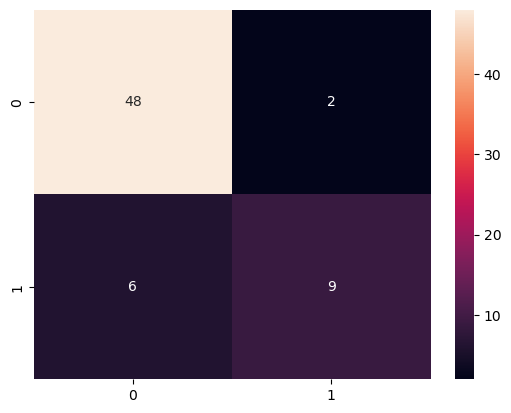

In [67]:
sns.heatmap(confusion_matrix(y_test,y_pred),annot=True)

In [68]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.89      0.96      0.92        50
           1       0.82      0.60      0.69        15

    accuracy                           0.88        65
   macro avg       0.85      0.78      0.81        65
weighted avg       0.87      0.88      0.87        65



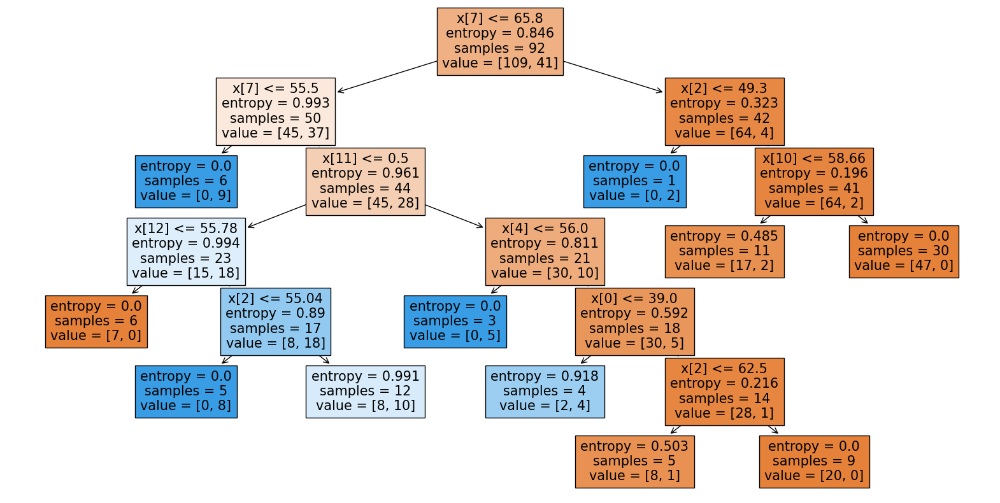

In [69]:
from sklearn.tree import export_graphviz
from sklearn import tree
import matplotlib.pyplot as plt

single_tree=rfbp.estimators_[0]

plt.figure(figsize=(20,10))
tree.plot_tree(single_tree,filled=True)
plt.show()

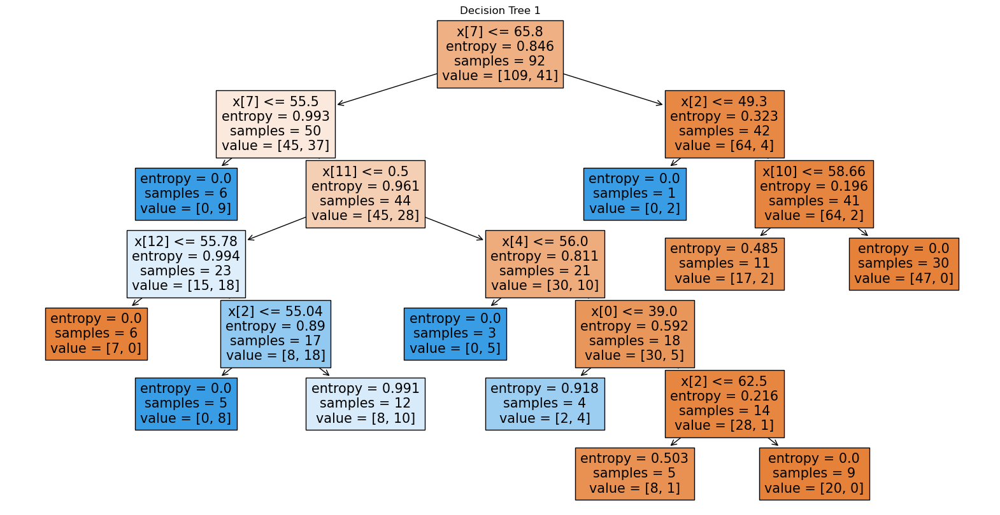

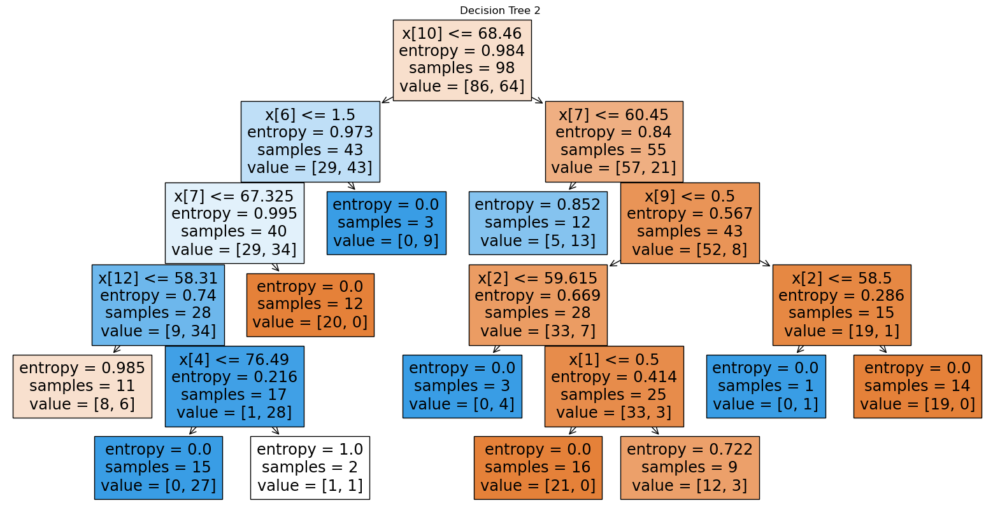

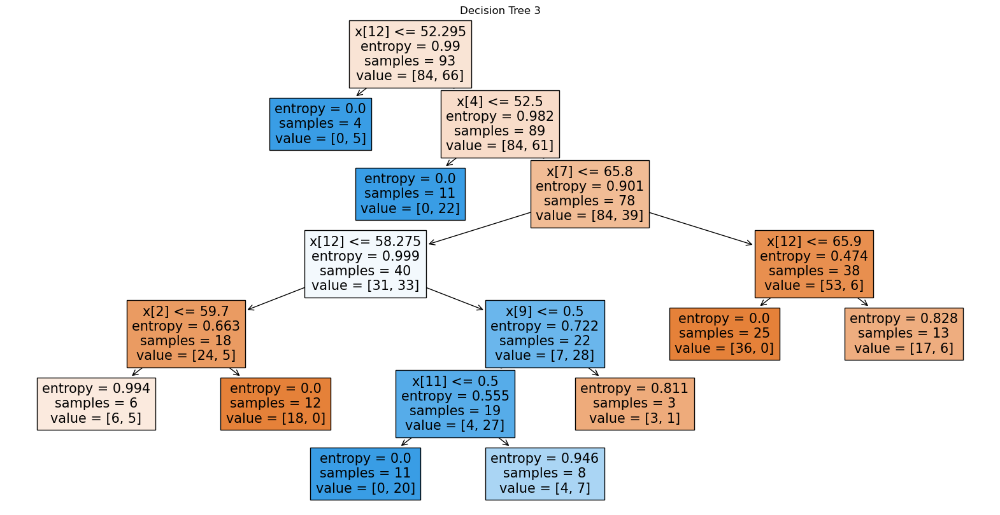

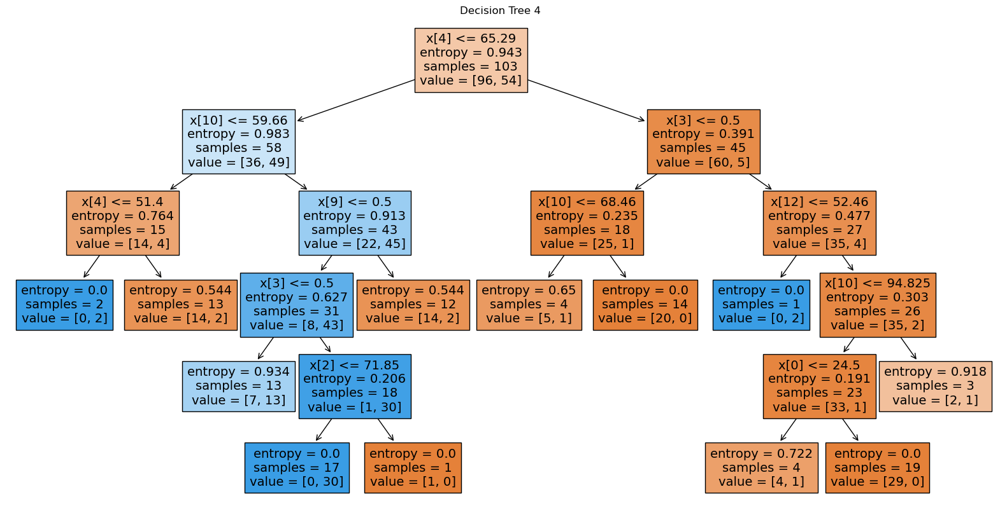

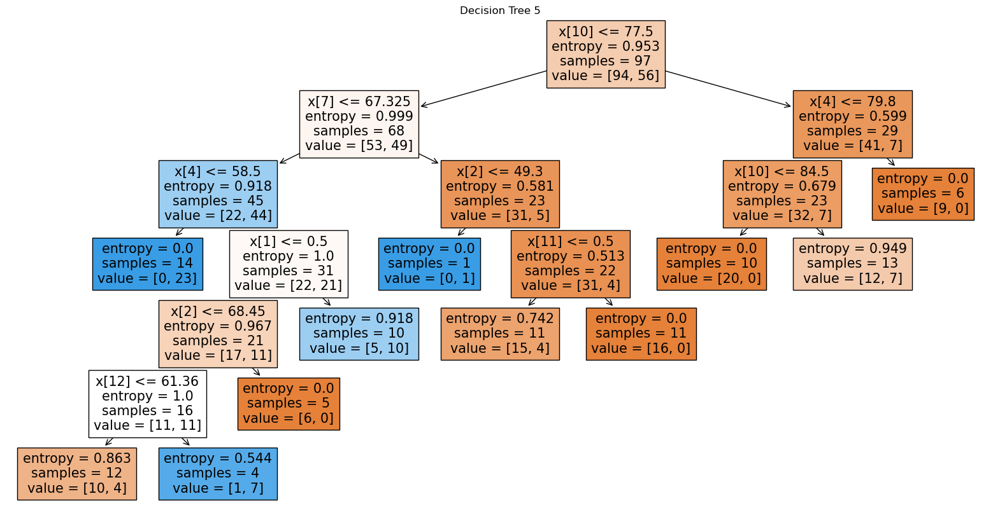

...

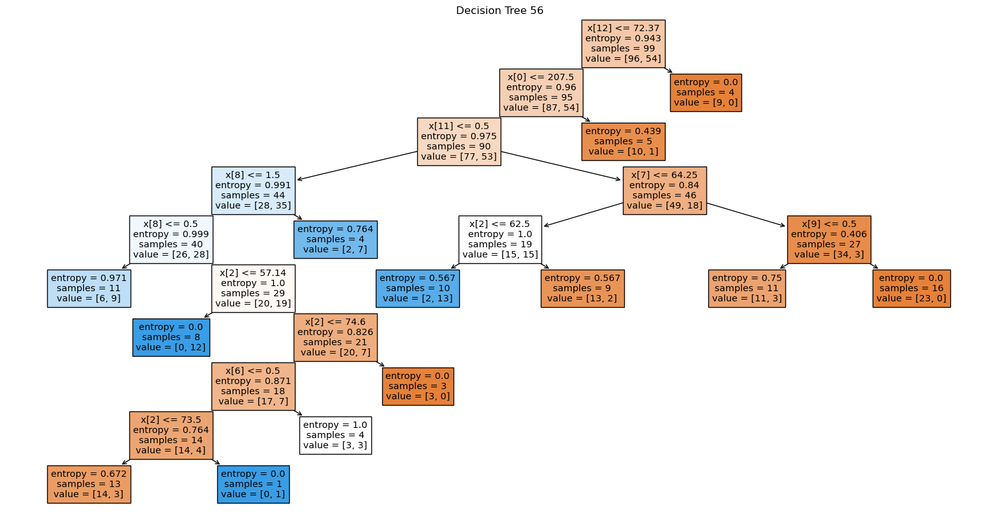

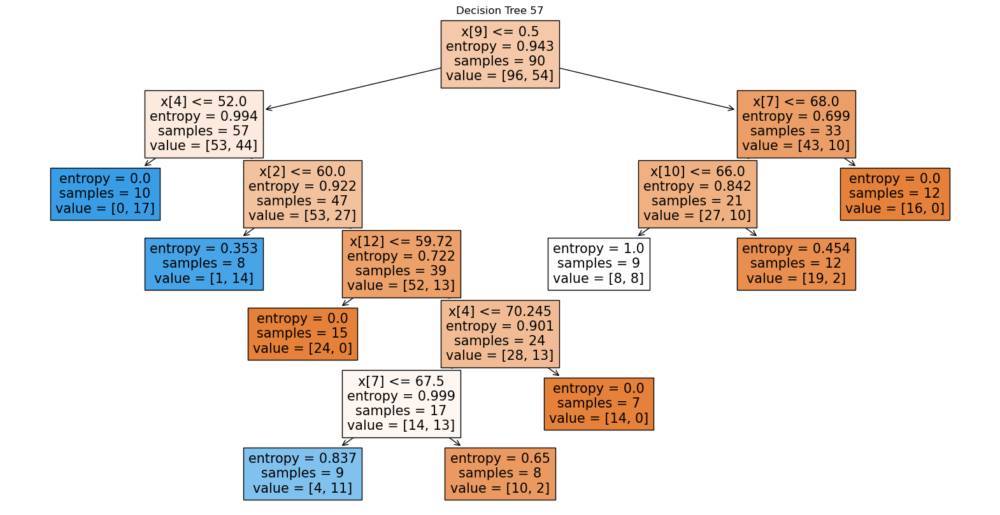

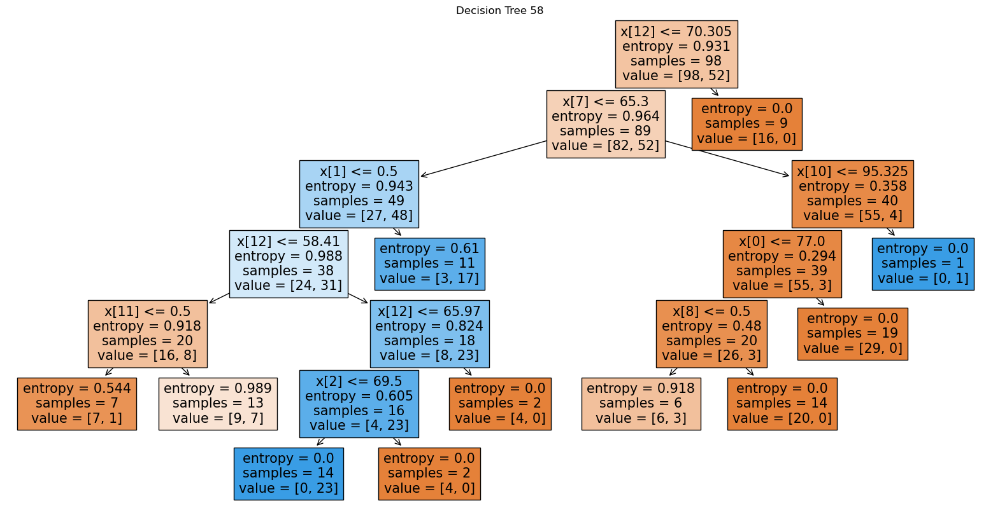

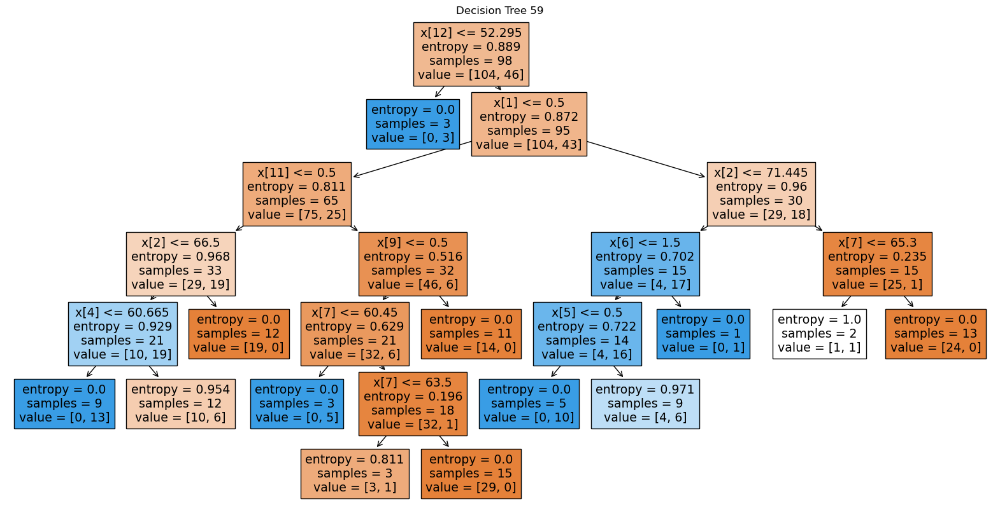

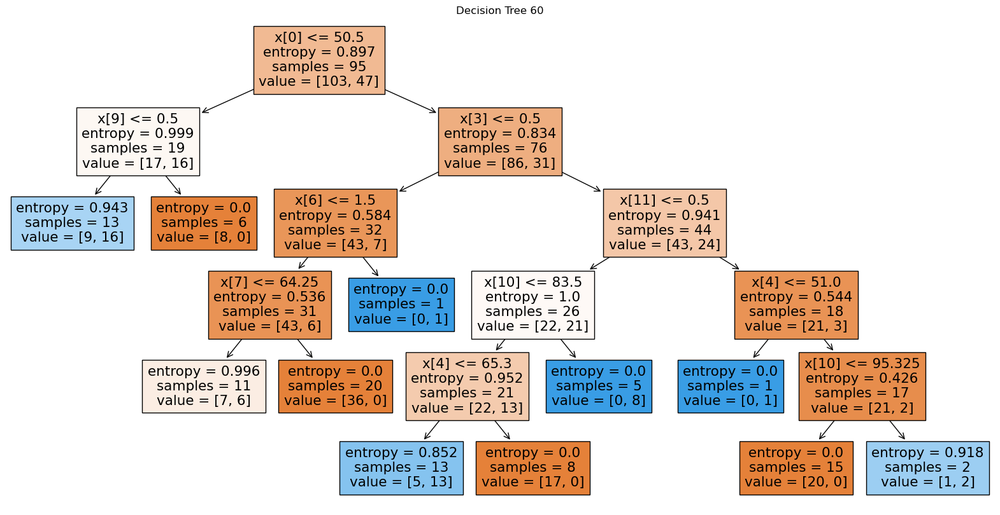

In [70]:
for i,single_tree in enumerate(rfbp.estimators_):
 

    plt.figure(figsize=(20,10))
    tree.plot_tree(single_tree,filled=True)
    plt.title(f"Decision Tree {i+1}")
    plt.show()

In [72]:
x=df_dummy_labelencoding.drop(["status","salary"],axis=1).values
y=df_dummy_labelencoding["status"].values

from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.25,random_state=50)

from sklearn.neighbors import KNeighborsClassifier
knn_model=KNeighborsClassifier(n_neighbors=5)
knn_model.fit(x_train,y_train)

y_pred=knn_model.predict(x_test)

In [99]:
from sklearn.metrics import accuracy_score,precision_score,recall_score,f1_score,confusion_matrix
print(f"Accuracy :{(accuracy_score(y_test,y_pred)*100).round(2)}")
print(f"Precision :{(precision_score(y_test,y_pred,average='weighted')*100).round(2)}")
print(f"Recall :{recall_score(y_test,y_pred,average='weighted')}")
print(f"f1 :{f1_score(y_test,y_pred,average='weighted')}")

Accuracy :83.33
Precision :83.86
Recall :0.8333333333333334
f1 :0.8356626506024097


In [103]:
df_dummy_labelencoding.head()

,sl_no,gender,ssc_p,ssc_b,hsc_p,hsc_b,hsc_s,degree_p,degree_t,workex,etest_p,specialisation,mba_p,status,salary
0,1,0,67.00,0,91.00,0,0,58.00,0,0,55.0,0,58.80,0,270000.0
1,2,0,79.33,1,78.33,0,1,77.48,0,1,86.5,1,66.28,0,200000.0
2,3,0,65.00,1,68.00,1,2,64.00,1,0,75.0,1,57.80,0,250000.0
3,4,0,56.00,1,52.00,1,1,52.00,0,0,66.0,0,59.43,1,0.0
4,5,0,85.80,1,73.60,1,0,73.30,1,0,96.8,1,55.50,0,425000.0


where k=1 and their accuracy= 70.37
where k=2 and their accuracy= 81.48
where k=3 and their accuracy= 79.63
where k=4 and their accuracy= 83.33
where k=5 and their accuracy= 83.33
where k=6 and their accuracy= 85.19
where k=7 and their accuracy= 87.04
where k=8 and their accuracy= 87.04
where k=9 and their accuracy= 85.19
where k=10 and their accuracy= 87.04
where k=11 and their accuracy= 87.04
where k=12 and their accuracy= 85.19
where k=13 and their accuracy= 83.33
where k=14 and their accuracy= 83.33
where k=15 and their accuracy= 81.48
where k=16 and their accuracy= 85.19
where k=17 and their accuracy= 83.33
where k=18 and their accuracy= 83.33
where k=19 and their accuracy= 83.33
where k=20 and their accuracy= 85.19


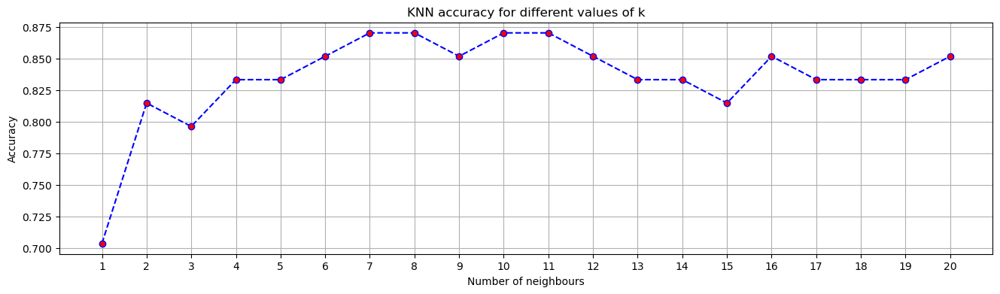

In [104]:
x=df_dummy_labelencoding.drop(["status","salary"],axis=1).values
y=df_dummy_labelencoding["status"].values

from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.25,random_state=50)

accuracy_scores=[]
k_values=range(1,21)
for k in k_values:
    knn_model=KNeighborsClassifier(n_neighbors=k)
    knn_model.fit(x_train,y_train)
    y_pred=knn_model.predict(x_test)
    accuracy=accuracy_score(y_test,y_pred)
    accuracy_scores.append(accuracy)
    print(f"where k={k} and their accuracy= {((accuracy)*100).round(2)}")


plt.figure(figsize=(16,4))
plt.plot(k_values,accuracy_scores,color='blue',linestyle='--',marker='o',markerfacecolor='red')
plt.xlabel('Number of neighbours')
plt.ylabel('Accuracy')
plt.title('KNN accuracy for different values of k')
plt.xticks(k_values)
plt.grid(True)
plt.show()